# Introduction

LendingClub is a US peer-to-peer lending company, headquartered in San Francisco, California.[3] It was the first peer-to-peer lender to register its offerings as securities with the Securities and Exchange Commission (SEC), and to offer loan trading on a secondary market. LendingClub is the world's largest peer-to-peer lending platform.

This case study covers the entire machine learning pipeline in an attempt to produce useful models with Deep Neural Networks (DNNs) that can be used in the loan industry. The study focuses on minimizing financial risk for the lending company. By conducting an in-depth Exploratory Data Analysis (EDA), we examine the relationships between variables. In the preprocessing stage, we transform the data and perform feature engineering to enhance our model predictions. Following this, we create a model using DNNs.


# The Dataset

**Overall Goal: Get an understanding for which variables are important, view summary statistics, and visualize the data**

## About the Dataset

We will be using a subset of the LendingClub DataSet obtained from Kaggle: https://www.kaggle.com/wordsforthewise/lending-club

There are many LendingClub data sets on Kaggle. Here is the information on this particular data set:

<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>LoanStatNew</th>
      <th>Description</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>loan_amnt</td>
      <td>The listed amount of the loan applied for by the borrower. If at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.</td>
    </tr>
    <tr>
      <th>1</th>
      <td>term</td>
      <td>The number of payments on the loan. Values are in months and can be either 36 or 60.</td>
    </tr>
    <tr>
      <th>2</th>
      <td>int_rate</td>
      <td>Interest Rate on the loan</td>
    </tr>
    <tr>
      <th>3</th>
      <td>installment</td>
      <td>The monthly payment owed by the borrower if the loan originates.</td>
    </tr>
    <tr>
      <th>4</th>
      <td>grade</td>
      <td>LC assigned loan grade</td>
    </tr>
    <tr>
      <th>5</th>
      <td>sub_grade</td>
      <td>LC assigned loan subgrade</td>
    </tr>
    <tr>
      <th>6</th>
      <td>emp_title</td>
      <td>The job title supplied by the Borrower when applying for the loan.*</td>
    </tr>
    <tr>
      <th>7</th>
      <td>emp_length</td>
      <td>Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years.</td>
    </tr>
    <tr>
      <th>8</th>
      <td>home_ownership</td>
      <td>The home ownership status provided by the borrower during registration or obtained from the credit report. Our values are: RENT, OWN, MORTGAGE, OTHER</td>
    </tr>
    <tr>
      <th>9</th>
      <td>annual_inc</td>
      <td>The self-reported annual income provided by the borrower during registration.</td>
    </tr>
    <tr>
      <th>10</th>
      <td>verification_status</td>
      <td>Indicates if income was verified by LC, not verified, or if the income source was verified</td>
    </tr>
    <tr>
      <th>11</th>
      <td>issue_d</td>
      <td>The month which the loan was funded</td>
    </tr>
    <tr>
      <th>12</th>
      <td>loan_status</td>
      <td>Current status of the loan</td>
    </tr>
    <tr>
      <th>13</th>
      <td>purpose</td>
      <td>A category provided by the borrower for the loan request.</td>
    </tr>
    <tr>
      <th>14</th>
      <td>title</td>
      <td>The loan title provided by the borrower</td>
    </tr>
    <tr>
      <th>15</th>
      <td>zip_code</td>
      <td>The first 3 numbers of the zip code provided by the borrower in the loan application.</td>
    </tr>
    <tr>
      <th>16</th>
      <td>addr_state</td>
      <td>The state provided by the borrower in the loan application</td>
    </tr>
    <tr>
      <th>17</th>
      <td>dti</td>
      <td>A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income.</td>
    </tr>
    <tr>
      <th>18</th>
      <td>earliest_cr_line</td>
      <td>The month the borrower's earliest reported credit line was opened</td>
    </tr>
    <tr>
      <th>19</th>
      <td>open_acc</td>
      <td>The number of open credit lines in the borrower's credit file.</td>
    </tr>
    <tr>
      <th>20</th>
      <td>pub_rec</td>
      <td>Number of derogatory public records</td>
    </tr>
    <tr>
      <th>21</th>
      <td>revol_bal</td>
      <td>Total credit revolving balance</td>
    </tr>
    <tr>
      <th>22</th>
      <td>revol_util</td>
      <td>Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.</td>
    </tr>
    <tr>
      <th>23</th>
      <td>total_acc</td>
      <td>The total number of credit lines currently in the borrower's credit file</td>
    </tr>
    <tr>
      <th>24</th>
      <td>initial_list_status</td>
      <td>The initial listing status of the loan. Possible values are – W, F</td>
    </tr>
    <tr>
      <th>25</th>
      <td>application_type</td>
      <td>Indicates whether the loan is an individual application or a joint application with two co-borrowers</td>
    </tr>
    <tr>
      <th>26</th>
      <td>mort_acc</td>
      <td>Number of mortgage accounts.</td>
    </tr>
    <tr>
      <th>27</th>
      <td>pub_rec_bankruptcies</td>
      <td>Number of public record bankruptcies</td>
    </tr>
  </tbody>
</table>

---
----

## Imports

In [247]:
import pandas as pd
import numpy as np


# data visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import missingno as msno

# Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# ANN
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Activation
from tensorflow.keras.constraints import max_norm
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.models import load_model
from tensorflow.keras.metrics import AUC

# Model Evaluation
from sklearn.metrics import classification_report,confusion_matrix, roc_auc_score


## Load Dataset Information CSV

A dataset containing descriptions for each variable was provided. Subsequently, we initiated an exploration of the dataset to understand its structure and content. Following this exploration, we developed a function to retrieve and read the description of a specified variable, enhancing our ability to access relevant information from the dataset.

In [248]:
data_info = pd.read_csv('lending_club_info.csv',index_col='LoanStatNew')

In [249]:
data_info

,Description
LoanStatNew,
loan_amnt,The listed amount of the loan applied for by t...
term,The number of payments on the loan. Values are...
int_rate,Interest Rate on the loan
installment,The monthly payment owed by the borrower if th...
grade,LC assigned loan grade
sub_grade,LC assigned loan subgrade
emp_title,The job title supplied by the Borrower when ap...
emp_length,Employment length in years. Possible values ar...
home_ownership,The home ownership status provided by the borr...


In [250]:
def feat_info(col_name):
    print(data_info.loc[col_name]['Description'])

# example
feat_info('mort_acc')

Number of mortgage accounts.


## Load the Dataset

In [251]:
df = pd.read_csv('lending_club_loan_two.csv')

In [252]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 396030 entries, 0 to 396029
Data columns (total 27 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             396030 non-null  float64
 1   term                  396030 non-null  object 
 2   int_rate              396030 non-null  float64
 3   installment           396030 non-null  float64
 4   grade                 396030 non-null  object 
 5   sub_grade             396030 non-null  object 
 6   emp_title             373103 non-null  object 
 7   emp_length            377729 non-null  object 
 8   home_ownership        396030 non-null  object 
 9   annual_inc            396030 non-null  float64
 10  verification_status   396030 non-null  object 
 11  issue_d               396030 non-null  object 
 12  loan_status           396030 non-null  object 
 13  purpose               396030 non-null  object 
 14  title                 394274 non-null  object 
 15  

In [253]:
df.shape

(396030, 27)

In [254]:
df.head(3)

,loan_amnt,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,...,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,application_type,mort_acc,pub_rec_bankruptcies,address
0,10000.0,36 months,11.44,329.48,B,B4,Marketing,10+ years,RENT,117000.0,...,16.0,0.0,36369.0,41.8,25.0,w,INDIVIDUAL,0.0,0.0,"0174 Michelle Gateway\nMendozaberg, OK 22690"
1,8000.0,36 months,11.99,265.68,B,B5,Credit analyst,4 years,MORTGAGE,65000.0,...,17.0,0.0,20131.0,53.3,27.0,f,INDIVIDUAL,3.0,0.0,"1076 Carney Fort Apt. 347\nLoganmouth, SD 05113"
2,15600.0,36 months,10.49,506.97,B,B3,Statistician,< 1 year,RENT,43057.0,...,13.0,0.0,11987.0,92.2,26.0,f,INDIVIDUAL,0.0,0.0,"87025 Mark Dale Apt. 269\nNew Sabrina, WV 05113"


In [255]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
loan_amnt,396030.0,14113.888089,8357.441341,500.00,8000.00,12000.00,20000.00,40000.00
int_rate,396030.0,13.639400,4.472157,5.32,10.49,13.33,16.49,30.99
installment,396030.0,431.849698,250.727790,16.08,250.33,375.43,567.30,1533.81
annual_inc,396030.0,74203.175798,61637.621158,0.00,45000.00,64000.00,90000.00,8706582.00
dti,396030.0,17.379514,18.019092,0.00,11.28,16.91,22.98,9999.00
open_acc,396030.0,11.311153,5.137649,0.00,8.00,10.00,14.00,90.00
pub_rec,396030.0,0.178191,0.530671,0.00,0.00,0.00,0.00,86.00
revol_bal,396030.0,15844.539853,20591.836109,0.00,6025.00,11181.00,19620.00,1743266.00
revol_util,395754.0,53.791749,24.452193,0.00,35.80,54.80,72.90,892.30
total_acc,396030.0,25.414744,11.886991,2.00,17.00,24.00,32.00,151.00


# Exploratory Data Analysis

**Overall Goal: Get an understanding for which variables are important, view summary statistics, and visualize the data**

## Missing Data

In [256]:
df.isna().mean()

loan_amnt               0.000000
term                    0.000000
int_rate                0.000000
installment             0.000000
grade                   0.000000
sub_grade               0.000000
emp_title               0.057892
emp_length              0.046211
home_ownership          0.000000
annual_inc              0.000000
verification_status     0.000000
issue_d                 0.000000
loan_status             0.000000
purpose                 0.000000
title                   0.004434
dti                     0.000000
earliest_cr_line        0.000000
open_acc                0.000000
pub_rec                 0.000000
revol_bal               0.000000
revol_util              0.000697
total_acc               0.000000
initial_list_status     0.000000
application_type        0.000000
mort_acc                0.095435
pub_rec_bankruptcies    0.001351
address                 0.000000
dtype: float64

<Axes: >

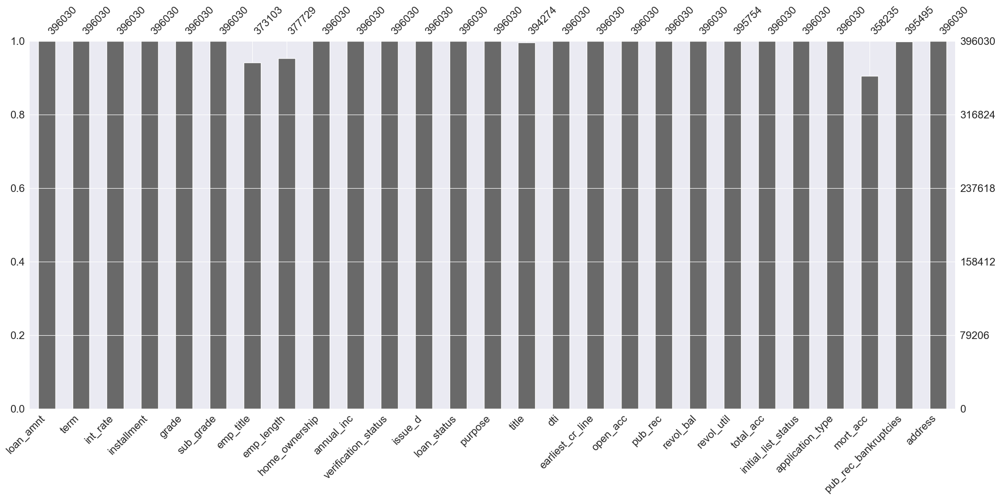

In [257]:
msno.bar(df)

<Axes: >

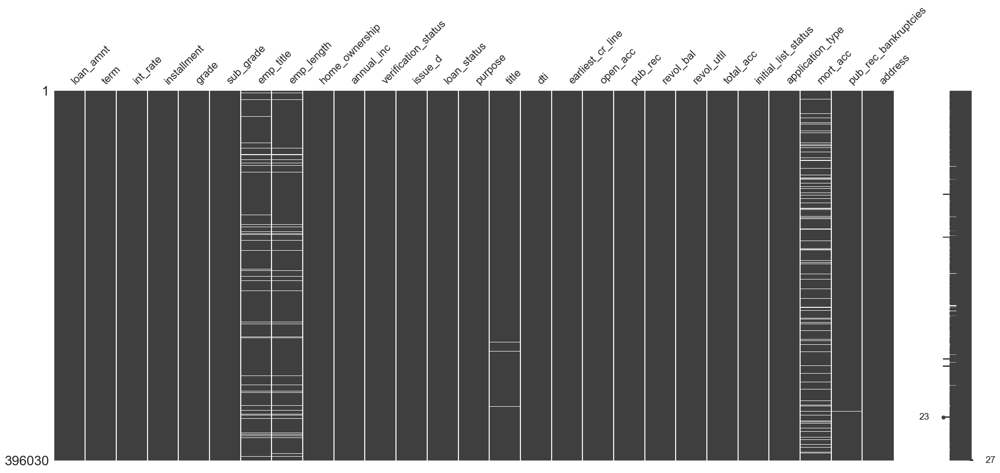

In [258]:
msno.matrix(df)

**Conclusions:** Based on the preceding graphs, it is evident that our data exhibits unequal column lengths and contains missing values across multiple columns. This aspect will be revisited and addressed in the preprocessing section, specifically in dealing with missing values.

## Loan Status Analysis

<Axes: xlabel='loan_status', ylabel='count'>

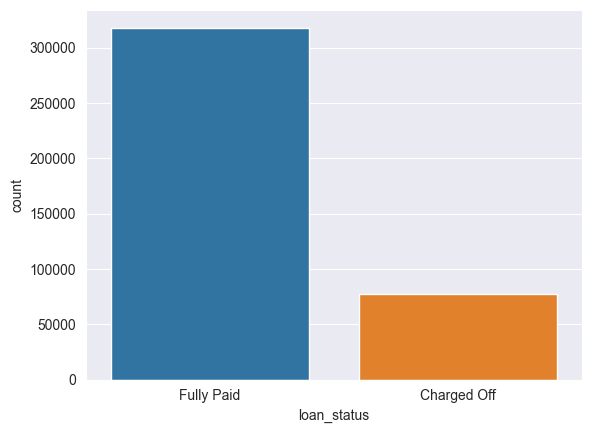

In [259]:
sns.set_style('darkgrid')
sns.countplot(data=df,x='loan_status',hue='loan_status')

In [260]:
px.histogram(data_frame=df,x='installment',color=df['loan_status'],nbins=50,
            opacity=.6)

In [261]:
px.histogram(data_frame= df,x='loan_amnt',color=df['loan_status'],nbins=50,
            opacity=.6)

<Axes: xlabel='loan_status', ylabel='installment'>

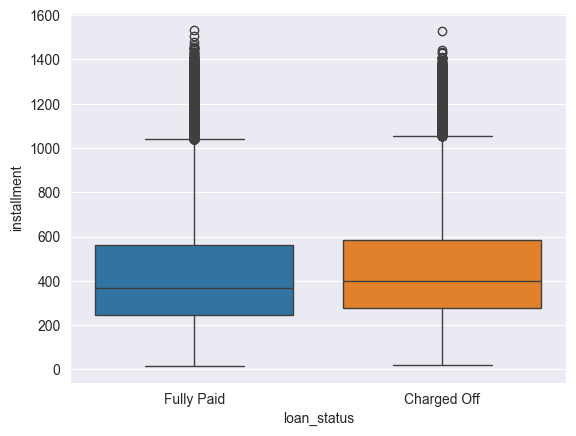

In [262]:
sns.boxplot(data=df,y='installment',x='loan_status',hue='loan_status')

## Correlation

<Axes: >

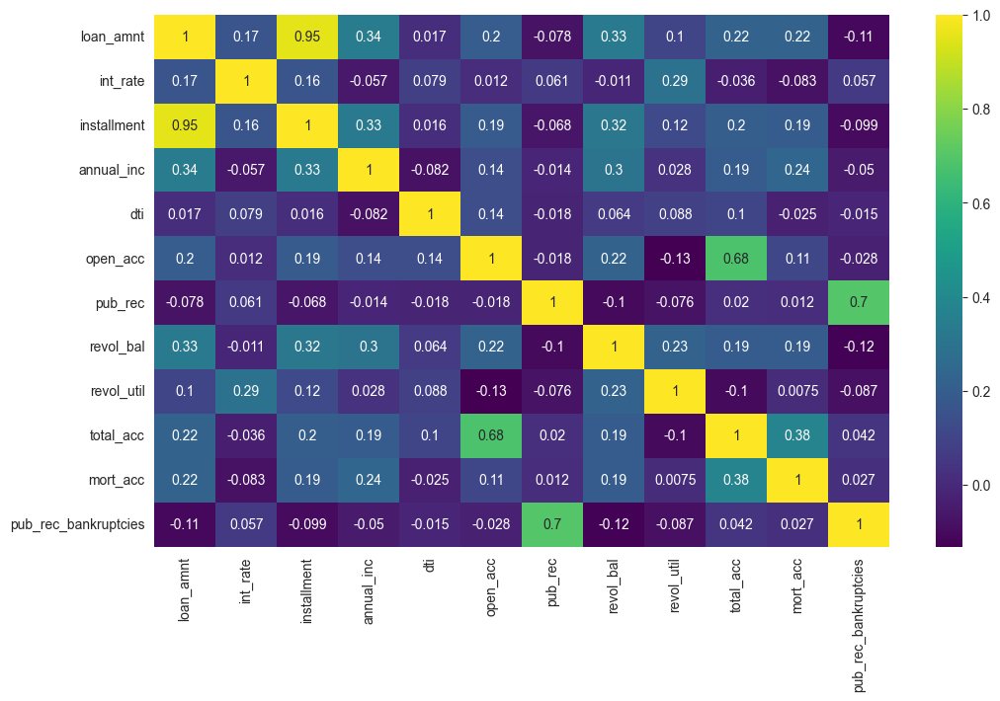

In [263]:
plt.figure(figsize=(12,7))
sns.heatmap(df.corr(numeric_only=True),annot=True,cmap='viridis')

**Conclusions:** A nearly perfect correlation exists between loan_amnt and installments. We will delve deeper into this relationship in the following segment.

## loan_amnt, loan_status and installment

In [264]:
feat_info('installment')
print('\n')
feat_info('loan_amnt')

The monthly payment owed by the borrower if the loan originates.


The listed amount of the loan applied for by the borrower. If at some point in time, the credit department reduces the loan amount, then it will be reflected in this value.


<Axes: xlabel='installment', ylabel='loan_amnt'>

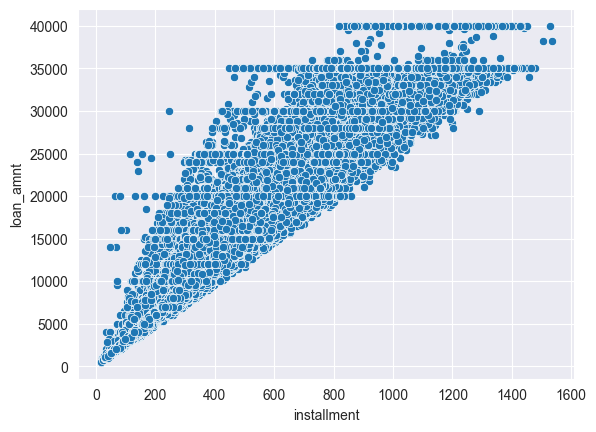

In [265]:
sns.scatterplot(x=df['installment'],y=df['loan_amnt'])

In [266]:
df.groupby('loan_status')['loan_amnt'].describe()

,count,mean,std,min,25%,50%,75%,max
loan_status,,,,,,,,
Charged Off,77673.0,15126.300967,8505.090557,1000.0,8525.0,14000.0,20000.0,40000.0
Fully Paid,318357.0,13866.878771,8302.319699,500.0,7500.0,12000.0,19225.0,40000.0


<Axes: xlabel='loan_status', ylabel='loan_amnt'>

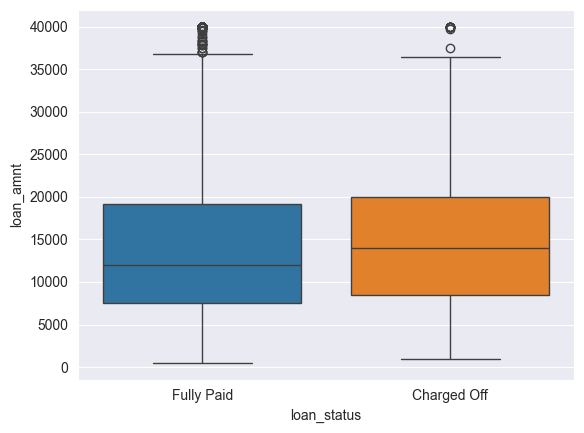

In [267]:
sns.boxplot(data=df,x='loan_status',y='loan_amnt',hue='loan_status')

## Grade and Subgrade Analysis

We will now proceed to analyze the Grade and SubGrade columns that LendingClub assigns to the loans.

In [268]:
px.histogram(data_frame=df ,x= 'grade',color=df['loan_status']
            ,barmode='group',
            opacity=.6,
            category_orders={'grade': sorted(df['grade'].unique())}).update_layout(
            margin=dict(l=10, r=10, t=10, b=10),
            paper_bgcolor="white"
)

In [269]:
px.histogram(data_frame=df ,x= 'sub_grade',color=df['loan_status']
            ,barmode='group',
            opacity=.6,
            category_orders={'sub_grade': sorted(df['sub_grade'].unique())})

In [270]:
px.bar(df['sub_grade'].value_counts(),
    opacity = .6)

**It looks like F and G subgrades don't get paid back that often. Isloate those and recreate the countplot just for those subgrades.**

<Axes: xlabel='grade', ylabel='count'>

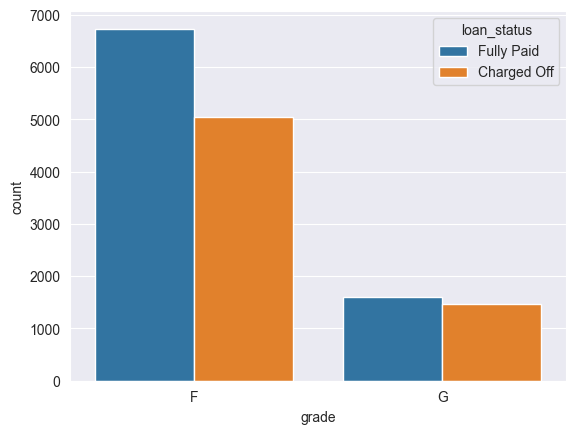

In [271]:
data = df[(df.grade == 'F') | (df.grade == 'G')]

sns.countplot(data=data,x= 'grade',hue='loan_status')

<Axes: xlabel='sub_grade', ylabel='count'>

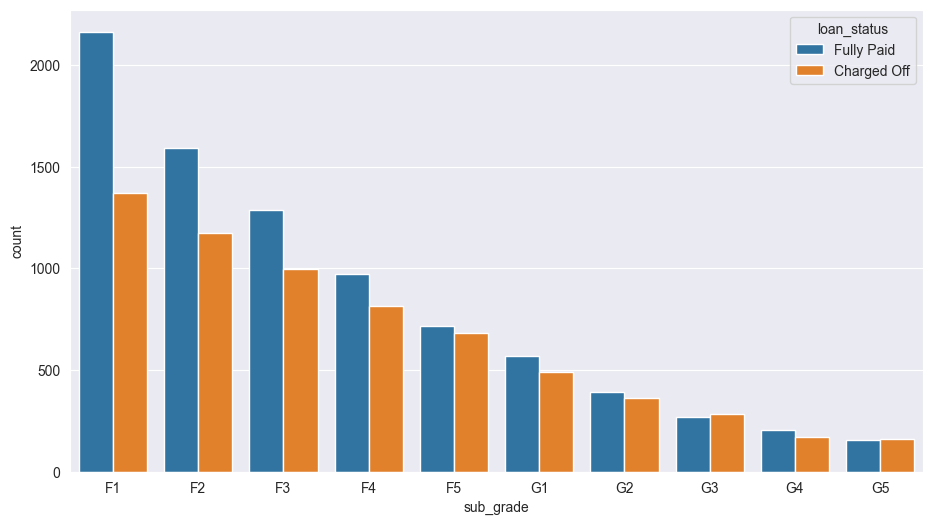

In [272]:
plt.figure(figsize=(11,6))

sns.countplot(data=data,x= 'sub_grade',hue='loan_status',order=sorted(data['sub_grade'].unique()))

## Loan Status

**Now we will generate a new column named 'loan_repaid' with a value of 1 for "Fully Paid" loan statuses and 0 for "Charged Off" statuses.**

In [273]:
df['loan_repaid'] = df['loan_status'].map({'Fully Paid':1,'Charged Off':0})
df[['loan_repaid','loan_status']]

,loan_repaid,loan_status
0,1,Fully Paid
1,1,Fully Paid
2,1,Fully Paid
3,1,Fully Paid
4,0,Charged Off
...,...,...
396025,1,Fully Paid
396026,1,Fully Paid
396027,1,Fully Paid
396028,1,Fully Paid


**Having computed the correlation with the 'loan_repaid' variable, it is evident that the interest rate demonstrates the most pronounced negative correlation with loan repayment. Individuals grappling with notably high interest rates face heightened difficulties in repaying their loans, intensifying the challenges associated with the repayment process for those with elevated interest rates.**

In [274]:
corr_loan =  df.corr(numeric_only=True)['loan_repaid'].drop('loan_repaid').sort_values(ascending=True)

px.bar(y=corr_loan.index,x=corr_loan.values)

# Data PreProcessing

**Section Goals: Remove or fill any missing data. Remove unnecessary or repetitive features. Convert categorical string features to dummy variables.**

## Missing Data

**To successfully address missing data, we will analyze the variables affected and decide whether to address null values through dropping, imputation, or removal.**

**Total length of dataframe**

In [275]:
len(df)

396030

**Total count of missing values per column**

In [276]:
df.isnull().sum()

loan_amnt                   0
term                        0
int_rate                    0
installment                 0
grade                       0
sub_grade                   0
emp_title               22927
emp_length              18301
home_ownership              0
annual_inc                  0
verification_status         0
issue_d                     0
loan_status                 0
purpose                     0
title                    1756
dti                         0
earliest_cr_line            0
open_acc                    0
pub_rec                     0
revol_bal                   0
revol_util                276
total_acc                   0
initial_list_status         0
application_type            0
mort_acc                37795
pub_rec_bankruptcies      535
address                     0
loan_repaid                 0
dtype: int64

**Percentage of missing values per column**

In [277]:
df.isnull().mean()*100

loan_amnt               0.000000
term                    0.000000
int_rate                0.000000
installment             0.000000
grade                   0.000000
sub_grade               0.000000
emp_title               5.789208
emp_length              4.621115
home_ownership          0.000000
annual_inc              0.000000
verification_status     0.000000
issue_d                 0.000000
loan_status             0.000000
purpose                 0.000000
title                   0.443401
dti                     0.000000
earliest_cr_line        0.000000
open_acc                0.000000
pub_rec                 0.000000
revol_bal               0.000000
revol_util              0.069692
total_acc               0.000000
initial_list_status     0.000000
application_type        0.000000
mort_acc                9.543469
pub_rec_bankruptcies    0.135091
address                 0.000000
loan_repaid             0.000000
dtype: float64

**Missing values are present in the following columns: emp_title, emp_length, title, revol_util, mort_acc, and pub_rec_bankruptcies.**

In [278]:
feat_info('emp_title')
print('\n')
feat_info('emp_length')
print('\n')
feat_info('title')
print('\n')
feat_info('revol_util')
print('\n')
feat_info('mort_acc')
print('\n')
feat_info('pub_rec_bankruptcies')

The job title supplied by the Borrower when applying for the loan.*


Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years. 


The loan title provided by the borrower


Revolving line utilization rate, or the amount of credit the borrower is using relative to all available revolving credit.


Number of mortgage accounts.


Number of public record bankruptcies


In [279]:
df['emp_title'].value_counts()

emp_title
Teacher                    4389
Manager                    4250
Registered Nurse           1856
RN                         1846
Supervisor                 1830
                           ... 
Postman                       1
McCarthy & Holthus, LLC       1
jp flooring                   1
Histology Technologist        1
Gracon Services, Inc          1
Name: count, Length: 173105, dtype: int64

**The presence of numerous distinct job titles makes it impractical to convert this information into a dummy variable feature. Consequently, we will proceed to remove the emp_title column.**

In [280]:
df = df.drop('emp_title',axis=1)

**TASK: Create a count plot of the emp_length feature column. Challenge: Sort the order of the values.**

In [281]:
px.histogram(data_frame=df ,x= 'emp_length',color=df['loan_status']
            ,barmode='group',
            opacity=.7,
            category_orders= {'emp_length': 
                    [ '< 1 year',
                    '1 year',
                    '2 years',
                    '3 years',
                    '4 years',
                    '5 years',
                    '6 years',
                    '7 years',
                    '8 years',
                    '9 years',
                    '10+ years']})

**The previous graph still does not provide a clear indication of a robust relationship between employment length and loan default. What we aim to ascertain is the percentage of charge-offs within each employment length category. Essentially, we are seeking information on the proportion of individuals in each employment category who did not fulfill their loan repayment.**

In [282]:
emp_co = df[df['loan_status']=="Charged Off"].groupby("emp_length").count()['loan_status']
emp_fp = df[df['loan_status']=="Fully Paid"].groupby("emp_length").count()['loan_status']
emp_len = emp_co/emp_fp

px.bar(x = emp_len.index,y=emp_len.values,category_orders= {'emp_length': 
                    [ '< 1 year',
                    '1 year',
                    '2 years',
                    '3 years',
                    '4 years',
                    '5 years',
                    '6 years',
                    '7 years',
                    '8 years',
                    '9 years',
                    '10+ years']})

**Charge-off rates demonstrate similarity across all employment lengths. Consequently, we will drop the emp_length column, as it does not exhibit substantial variations in charge-off rates. The likelihood of an individual not repaying their loans appears consistent at around 20%, regardless of the specific employment length.**

In [283]:
df = df.drop('emp_length', axis=1)

**We revisit the DataFrame to see what feature columns still have missing data.**

In [284]:
df.isnull().sum()

loan_amnt                   0
term                        0
int_rate                    0
installment                 0
grade                       0
sub_grade                   0
home_ownership              0
annual_inc                  0
verification_status         0
issue_d                     0
loan_status                 0
purpose                     0
title                    1756
dti                         0
earliest_cr_line            0
open_acc                    0
pub_rec                     0
revol_bal                   0
revol_util                276
total_acc                   0
initial_list_status         0
application_type            0
mort_acc                37795
pub_rec_bankruptcies      535
address                     0
loan_repaid                 0
dtype: int64

In [285]:
df[['title', 'purpose']].head(10)

,title,purpose
0,Vacation,vacation
1,Debt consolidation,debt_consolidation
2,Credit card refinancing,credit_card
3,Credit card refinancing,credit_card
4,Credit Card Refinance,credit_card
5,Debt consolidation,debt_consolidation
6,Home improvement,home_improvement
7,No More Credit Cards,credit_card
8,Debt consolidation,debt_consolidation
9,Debt Consolidation,debt_consolidation


**The title column serves as a string subcategory or description of the purpose column. Therefore, we can proceed to drop the title column.**

In [286]:
df = df.drop('title',axis=1)

**Next, we'll tackle the missing data in the mort_acc column. Given the robust correlation observed between mort_acc and total_acc, our approach involves grouping the dataframe by total_acc and calculating the mean value for mort_acc within each corresponding total_acc entry. This procedure will yield the specified result below:**

In [287]:
total_acc_avg = df.groupby('total_acc')['mort_acc'].mean()

In [288]:
df.corr(numeric_only=True)['mort_acc'].sort_values()

int_rate               -0.082583
dti                    -0.025439
revol_util              0.007514
pub_rec                 0.011552
pub_rec_bankruptcies    0.027239
loan_repaid             0.073111
open_acc                0.109205
installment             0.193694
revol_bal               0.194925
loan_amnt               0.222315
annual_inc              0.236320
total_acc               0.381072
mort_acc                1.000000
Name: mort_acc, dtype: float64

In [289]:
def fill_mort_acc(total_acc,mort_acc):
    '''
    Accepts the total_acc and mort_acc values for the row.
    Checks if the mort_acc is NaN , if so, it returns the avg mort_acc value
    for the corresponding total_acc value for that row.
    
    total_acc_avg here should be a Series or dictionary containing the mapping of the
    groupby averages of mort_acc per total_acc values.
    '''
    if np.isnan(mort_acc):
        return total_acc_avg[total_acc]
    else:
        return mort_acc

In [290]:
df['mort_acc'] = df.apply(lambda x: fill_mort_acc(x['total_acc'], x['mort_acc']), axis=1)

**The revol_util and pub_rec_bankruptcies columns contain some missing data points, collectively constituting less than 0.5% of the total dataset. You can proceed to eliminate the rows with missing values in these columns using the dropna() function.**

In [291]:
df = df.dropna()

In [292]:
df.isnull().sum()

loan_amnt               0
term                    0
int_rate                0
installment             0
grade                   0
sub_grade               0
home_ownership          0
annual_inc              0
verification_status     0
issue_d                 0
loan_status             0
purpose                 0
dti                     0
earliest_cr_line        0
open_acc                0
pub_rec                 0
revol_bal               0
revol_util              0
total_acc               0
initial_list_status     0
application_type        0
mort_acc                0
pub_rec_bankruptcies    0
address                 0
loan_repaid             0
dtype: int64

## Categorical variables and dummy variable

In [293]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 395219 entries, 0 to 396029
Data columns (total 25 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   loan_amnt             395219 non-null  float64
 1   term                  395219 non-null  object 
 2   int_rate              395219 non-null  float64
 3   installment           395219 non-null  float64
 4   grade                 395219 non-null  object 
 5   sub_grade             395219 non-null  object 
 6   home_ownership        395219 non-null  object 
 7   annual_inc            395219 non-null  float64
 8   verification_status   395219 non-null  object 
 9   issue_d               395219 non-null  object 
 10  loan_status           395219 non-null  object 
 11  purpose               395219 non-null  object 
 12  dti                   395219 non-null  float64
 13  earliest_cr_line      395219 non-null  object 
 14  open_acc              395219 non-null  float64
 15  pub_r

In [294]:
df.select_dtypes(['object']).columns

Index(['term', 'grade', 'sub_grade', 'home_ownership', 'verification_status',
       'issue_d', 'loan_status', 'purpose', 'earliest_cr_line',
       'initial_list_status', 'application_type', 'address'],
      dtype='object')

**We will analyze and modify each of the string features to determine the necessary actions for each.**


**Convert the term feature into either a 36 or 60 integer numeric data type**

In [295]:
df['term'].value_counts()

term
 36 months    301247
 60 months     93972
Name: count, dtype: int64

In [296]:
df['term'] = df['term'].apply(lambda term: int(term[:3]))

**We already know grade is part of sub_grade, so just drop the grade feature.**

In [297]:
df = df.drop('grade',axis=1)

**Convert the subgrade into dummy variables. Then concatenate these new columns to the original dataframe.**

In [298]:
subgrade_dummies = pd.get_dummies(df['sub_grade'],drop_first=True)

In [299]:
df = pd.concat([df.drop('sub_grade',axis=1),subgrade_dummies],axis=1)

In [300]:
df.columns

Index(['loan_amnt', 'term', 'int_rate', 'installment', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'loan_status',
       'purpose', 'dti', 'earliest_cr_line', 'open_acc', 'pub_rec',
       'revol_bal', 'revol_util', 'total_acc', 'initial_list_status',
       'application_type', 'mort_acc', 'pub_rec_bankruptcies', 'address',
       'loan_repaid', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5',
       'C1', 'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2',
       'E3', 'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3', 'G4',
       'G5'],
      dtype='object')

### verification_status, application_type,initial_list_status,purpose 
**We proceed to convert these columns: ['verification_status', 'application_type','initial_list_status','purpose'] into dummy variables and concatenate them with the original dataframe.**

In [301]:
dummies = pd.get_dummies(df[['verification_status', 'application_type','initial_list_status','purpose' ]],drop_first=True)
df = df.drop(['verification_status', 'application_type','initial_list_status','purpose'],axis=1)
df = pd.concat([df,dummies],axis=1)

In [302]:
df['home_ownership'].value_counts()

home_ownership
MORTGAGE    198022
RENT        159395
OWN          37660
OTHER          110
NONE            29
ANY              3
Name: count, dtype: int64

**We proceed to convert these so that we end up with just 4 categories, MORTGAGE, RENT, OWN, OTHER. Then concatenate them with the original dataframe.**

In [303]:
df['home_ownership']=df['home_ownership'].replace(['NONE', 'ANY'], 'OTHER')

dummies = pd.get_dummies(df['home_ownership'],drop_first=True)
df = df.drop('home_ownership',axis=1)
df = pd.concat([df,dummies],axis=1)

### address
**We proceed to feature engineer a zip code column from the address in the data set.**

In [304]:
df['zip_code'] = df['address'].apply(lambda address:address[-5:])

In [305]:
dummies = pd.get_dummies(df['zip_code'],drop_first=True)
df = df.drop(['zip_code','address'],axis=1)
df = pd.concat([df,dummies],axis=1)

### issue_d 

**Keeping this would be data leakage, we wouldn't know beforehand whether or not a loan would be issued when using our model, so we drop this feature.**

In [306]:
df = df.drop('issue_d',axis=1)

### earliest_cr_line
**TASK: This appears to be a historical time stamp feature. We extract the year from this feature, then convert it to a numeric feature. Then drop the earliest_cr_line feature.**

In [307]:
df['earliest_cr_year'] = df['earliest_cr_line'].apply(lambda date:int(date[-4:]))
df = df.drop('earliest_cr_line',axis=1)

In [308]:
df.select_dtypes(['object']).columns

Index(['loan_status'], dtype='object')

## Train Test Split

**We Proceed to drop the load_status column we created earlier, since its a duplicate of the loan_repaid column. We'll use the loan_repaid column since its already in 0s and 1s.**

In [309]:
df = df.drop('loan_status',axis=1)

In [310]:
X = df.drop('loan_repaid',axis=1).values
y = df['loan_repaid'].values

In [311]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=101)

## Normalizing the Data

In [312]:
scaler = MinMaxScaler()

In [313]:
X_train = scaler.fit_transform(X_train)

In [314]:
X_test = scaler.transform(X_test)

# Creating a Model

In [315]:
model = Sequential()

# input layer
model.add(Dense(78,activation='relu'))
#model.add(Dropout(0.2))

# hidden layer
model.add(Dense(39,activation='relu'))
#model.add(Dropout(0.2))

# hidden layer
model.add(Dense(19,activation='relu'))
#model.add(Dropout(0.2))

# hidden layer
model.add(Dense(8,activation='relu'))
#model.add(Dropout(0.2))

# hidden layer
model.add(Dense(4,activation='relu'))
#model.add(Dropout(0.2))

# output layer
model.add(Dense(1, activation='sigmoid'))

# compile model
model.compile(optimizer="adam", loss='binary_crossentropy',metrics=[AUC(name='AUC')])

In [316]:
early_stop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=10)

## Training

In [317]:
model.fit(x=X_train, 
          y=y_train, 
          epochs=400,
          verbose = 2,
          batch_size=32,
          validation_data=(X_test, y_test),
          callbacks=[early_stop])

Epoch 1/400
9881/9881 - 7s - loss: 0.2692 - AUC: 0.8936 - val_loss: 0.2634 - val_AUC: 0.8999 - 7s/epoch - 702us/step
Epoch 2/400
9881/9881 - 6s - loss: 0.2605 - AUC: 0.9009 - val_loss: 0.2629 - val_AUC: 0.9010 - 6s/epoch - 650us/step
Epoch 3/400
9881/9881 - 6s - loss: 0.2595 - AUC: 0.9021 - val_loss: 0.2619 - val_AUC: 0.9014 - 6s/epoch - 645us/step
Epoch 4/400
9881/9881 - 6s - loss: 0.2588 - AUC: 0.9029 - val_loss: 0.2638 - val_AUC: 0.9018 - 6s/epoch - 646us/step
Epoch 5/400
9881/9881 - 6s - loss: 0.2582 - AUC: 0.9037 - val_loss: 0.2614 - val_AUC: 0.9023 - 6s/epoch - 647us/step
Epoch 6/400
9881/9881 - 6s - loss: 0.2578 - AUC: 0.9040 - val_loss: 0.2610 - val_AUC: 0.9027 - 6s/epoch - 638us/step
Epoch 7/400
9881/9881 - 7s - loss: 0.2575 - AUC: 0.9045 - val_loss: 0.2608 - val_AUC: 0.9027 - 7s/epoch - 736us/step
Epoch 8/400
9881/9881 - 7s - loss: 0.2571 - AUC: 0.9051 - val_loss: 0.2609 - val_AUC: 0.9027 - 7s/epoch - 669us/step
Epoch 9/400
9881/9881 - 6s - loss: 0.2567 - AUC: 0.9054 - val_lo

# Evaluating Model Performance

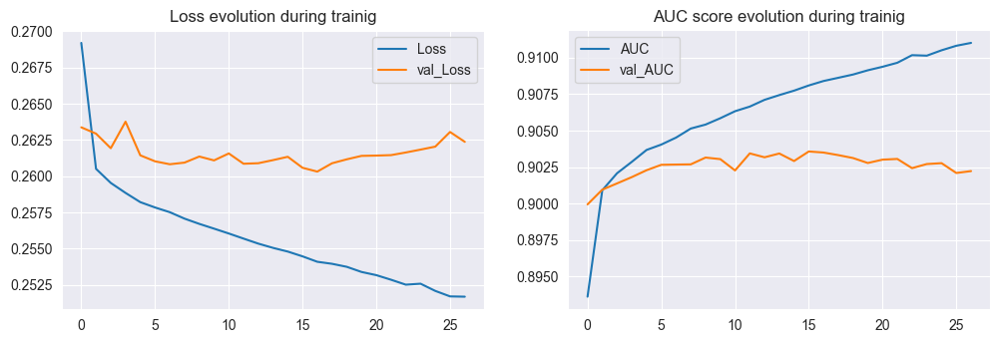

In [318]:
error_df = pd.DataFrame(model.history.history)

plt.figure(figsize=(12, 8))

plt.subplot(2, 2, 1)
plt.plot(error_df['loss'], label='Loss')
plt.plot(error_df['val_loss'], label='val_Loss')
plt.title('Loss evolution during trainig')
plt.legend()

plt.subplot(2, 2, 2)
plt.plot(error_df['AUC'], label='AUC')
plt.plot(error_df['val_AUC'], label='val_AUC')
plt.title('AUC score evolution during trainig')
plt.legend();


In [319]:
predictions = (model.predict(X_test) > 0.5).astype("int32")

2471/2471 [==============================] - 1s 343us/step


In [320]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.93      0.47      0.62     15658
           1       0.88      0.99      0.93     63386

    accuracy                           0.89     79044
   macro avg       0.91      0.73      0.78     79044
weighted avg       0.89      0.89      0.87     79044



In [321]:
print(roc_auc_score(y_test, predictions))

0.729663670612902


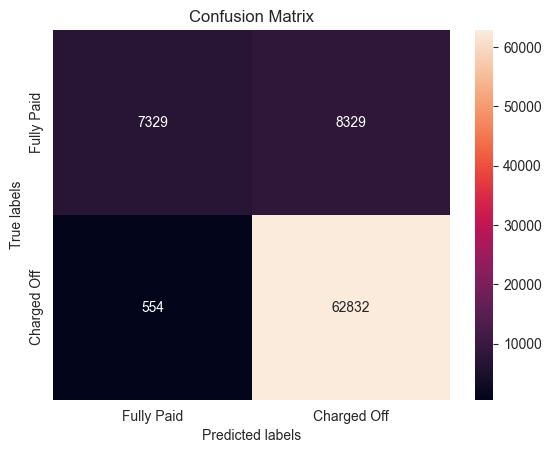

In [322]:
ax= plt.subplot()
sns.heatmap(confusion_matrix(y_test, predictions),annot=True, fmt='g', ax=ax);  #annot=True to annotate cells, ftm='g' to disable scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(['Fully Paid', 'Charged Off']); ax.yaxis.set_ticklabels(['Fully Paid', 'Charged Off']);

# References

Python for Data Science and Machine Learning Bootcamp - https://www.udemy.com/course/python-for-data-science-and-machine-learning-bootcamp/